In [1]:
import tweets
import langdetect
import pandas as pd
import re
from gensim.models import Word2Vec
import numpy as np
import os
from gensim.models import KeyedVectors
from gensim.models import TfidfModel
from gensim.corpora import Dictionary
from sklearn.manifold import TSNE
import plotly.express as px

from sklearn.cluster import KMeans 
from sklearn import metrics 
from scipy.spatial.distance import cdist 
import matplotlib.pyplot as plt  
from googletrans import Translator

# Word2Vec Embedding + Clustering By Similarity

The purpose of this notebook is to transform tweets into vectors and then cluster them by similarity.

## Create Datasets

In [2]:
tweets1 = pd.read_csv("../data/tweets1.csv").drop_duplicates()
users1 = pd.read_csv("../data/users1.csv").drop_duplicates()

/Users/nlee/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3071: DtypeWarning: Columns (6,15,19,30) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [3]:
tweet, user = tweets.find_random_user(users1, tweets1)

/Users/nlee/Desktop/projects/chinabots/scripts/tweets.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["tweet_time"] = pd.to_datetime(df["tweet_time"], errors="coerce")


In [4]:
tweet = pd.DataFrame()
for i in range(100):
    tweet1, user1 = tweets.find_random_user(users1, tweets1)
    tweet = pd.concat([tweet, tweet1])

## Preprocess Data

In [15]:
english_df = tweet.loc[tweet["tweet_language"]=="en"].reset_index()
english_tweets = english_df["tweet_text"]

sentences = list(english_tweets.apply(lambda x:
                          re.sub("[\'\"\,\.\?\!\@\:\;|`\+\=\\|\\-\[\]\{\}\)\(\)]+", "", x)
                          .split()))

## Generate Vectors

In [16]:
model = KeyedVectors.load_word2vec_format(os.path.join("../data/", 'wiki.en.vec'), binary=False) 

In [17]:
dct = Dictionary(sentences)
corpus = [dct.doc2bow(line) for line in sentences]
tfidf_model = TfidfModel(corpus)

In [18]:
len(corpus)

79438

In [20]:
key = []
value = []
for ind in range(len(sentences)):
    avgs = []
    corp = tfidf_model[corpus[ind]]
    for word_ind in range(len(corp)):
        try:
            vec_mean = np.array(model[dct[corp[word_ind][0]]])
        except KeyError:
            continue
        tfidf = corp[word_ind][1]
        avg = vec_mean*tfidf
        avgs.append(avg)
    key.append(english_tweets[ind])
    value.append(np.average(np.array(avgs), axis=0))   
avg_wordvec = pd.DataFrame({"tweet": key, "word2vec": value, "time": english_df["tweet_time"]})

/Users/nlee/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/function_base.py:393: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/Users/nlee/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


## Visualize Results 

In order to visualize the results, we conducted a TSNE transformation.

In [21]:
# Prepare dataset to be compatible with TSNE
avg_wordvec = avg_wordvec.loc[~avg_wordvec["word2vec"].isnull()]

X = np.stack(avg_wordvec["word2vec"].to_list())
y = TSNE(learning_rate=10).fit_transform(X)
word2vec_df =avg_wordvec.merge(pd.DataFrame(y), left_index=True, right_index=True)

In [22]:
# Unclustered plot
df = word2vec_df[["tweet", 0, 1]]

fig = px.scatter(df, x=0, y=1, title="Tweets Plotted", hover_data=[df.index])
fig.show()

## Clustering Data Points

In [26]:
x1 = np.array(word2vec_df[0])
x2 = np.array(word2vec_df[1])

X = np.array(list(zip(x1, x2))).reshape(len(x1), 2) 

First, we needed to determine the number of clusters we would have. For this, we used the elbow method.

In [27]:
distortions = [] 
inertias = [] 
mapping1 = {} 
mapping2 = {} 
K = range(1,20) 
  
for k in K: 
    #Building and fitting the model 
    kmeanModel = KMeans(n_clusters=k).fit(X) 
    kmeanModel.fit(X)     
      
    distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_, 
                      'euclidean'),axis=1)) / X.shape[0]) 
    inertias.append(kmeanModel.inertia_) 
  
    mapping1[k] = sum(np.min(cdist(X, kmeanModel.cluster_centers_, 
                 'euclidean'),axis=1)) / X.shape[0] 
    mapping2[k] = kmeanModel.inertia_ 

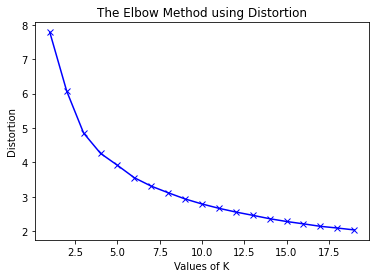

In [28]:
plt.plot(K, distortions, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Distortion') 
plt.title('The Elbow Method using Distortion') 
plt.show() 

Judging by our graph, we saw that the slope seemed to have drastically decreased at around k=7. Thus, we used seven clusters in our final visualization.

In [29]:
kmeanModel = KMeans(n_clusters=7).fit(X) 
kmeanModel.fit(X)  
groups = kmeanModel.predict(X)

In [32]:
# Clustered Plot
df = word2vec_df[["tweet", 0, 1]]
df["groups"] = groups

fig = px.scatter(df, x=0, y=1, title="Tweets Plotted", hover_data=["tweet"], color="groups", color_continuous_scale=px.colors.sequential.GnBu)
fig.show()

<ipython-input-32-56855ae480d3>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

